### Carlos Alexandre Silva dos Santos - 20210025904

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Layer
from tensorflow.keras.layers import (Reshape,LeakyReLU,Dropout,Conv2DTranspose, Add, Conv2D, MaxPool2D, Dense,
                                     Flatten, InputLayer, BatchNormalization, Input, )
from tensorflow.keras.optimizers import Adam


## Arquitetura DCGAN

O DCGAN (Deep Convolutional Generative Adversarial Network) é uma variação das GANs (Redes Adversárias Generativas) que utiliza redes neurais convolucionais profundas para geração de imagens.

Ele consiste em dois componentes principais:

- **Gerador (Generator):** Tenta gerar imagens realistas a partir de vetores de ruído aleatórios.
- **Discriminador (Discriminator):** Tenta distinguir entre imagens reais (do dataset) e imagens falsas (geradas).

Esses dois modelos são treinados de forma adversarial: o Gerador tenta enganar o Discriminador, enquanto o Discriminador tenta melhorar sua capacidade de identificar imagens falsas.



## Arquitetura do Gerador

O Gerador é uma rede neural convolucional que começa com um vetor de ruído (geralmente com distribuição normal) e o transforma em uma imagem com dimensões reais (por exemplo, 64x64 pixels com 3 canais de cor).

A arquitetura típica inclui:

- Camadas de **transposed convolution** (deconvolução) para aumentar a dimensão da imagem gradualmente.
- **BatchNorm** após cada camada para estabilizar o treinamento.
- **ReLU** como função de ativação (exceto na última camada, que usa Tanh).



## Arquitetura do Discriminador

O Discriminador é uma rede neural convolucional que recebe uma imagem e retorna a probabilidade de ela ser real.

A arquitetura inclui:

- Camadas de **convolução** que reduzem progressivamente a dimensão da imagem.
- **BatchNorm** após cada camada (exceto a primeira).
- **LeakyReLU** como função de ativação.
- Camada final com ativação **sigmoid** para retornar uma probabilidade.


Referência: https://arxiv.org/abs/1511.06434

# Dados

## Download dos Dados

In [ ]:
# Instala silenciosamente a biblioteca 'kaggle', necessária para baixar datasets do site Kaggle
!pip install -q kaggle

# Cria o diretório oculto .kaggle na home do usuário, onde a chave de API será armazenada
! mkdir ~/.kaggle

# Copia o arquivo de chave da API (kaggle.json) para o diretório .kaggle
! cp kaggle.json ~/.kaggle/

# Altera as permissões do arquivo para que apenas o dono possa lê-lo — necessário por segurança
!chmod 600 /root/.kaggle/kaggle.json

# Faz o download do dataset CelebA (rostos de celebridades) do Kaggle
!kaggle datasets download -d jessicali9530/celeba-dataset

# Descompacta o conteúdo do arquivo zipado na pasta especificada
!unzip "/content/celeba-dataset.zip" -d "/content/dataset/"


A saída de streaming foi truncada nas últimas 5000 linhas.
  inflating: /content/dataset/img_align_celeba/img_align_celeba/197604.jpg  
  inflating: /content/dataset/img_align_celeba/img_align_celeba/197605.jpg  
  inflating: /content/dataset/img_align_celeba/img_align_celeba/197606.jpg  
  inflating: /content/dataset/img_align_celeba/img_align_celeba/197607.jpg  
  inflating: /content/dataset/img_align_celeba/img_align_celeba/197608.jpg  
  inflating: /content/dataset/img_align_celeba/img_align_celeba/197609.jpg  
  inflating: /content/dataset/img_align_celeba/img_align_celeba/197610.jpg  
  inflating: /content/dataset/img_align_celeba/img_align_celeba/197611.jpg  
  inflating: /content/dataset/img_align_celeba/img_align_celeba/197612.jpg  
  inflating: /content/dataset/img_align_celeba/img_align_celeba/197613.jpg  
  inflating: /content/dataset/img_align_celeba/img_align_celeba/197614.jpg  
  inflating: /content/dataset/img_align_celeba/img_align_celeba/197615.jpg  
  inflating: /con

## Preparação dos dados

In [ ]:
# Tamanho do lote utilizado no treinamento — quantas imagens são processadas por vez
BATCH_SIZE = 128

# Formato das imagens: 64x64 pixels, com 3 canais de cor (RGB)
IM_SHAPE = (64, 64, 3)

# Taxa de aprendizado utilizada pelos otimizadores Adam do gerador e do discriminador
LEARNING_RATE = 2e-4  # Equivalente a 0.0002

# Dimensão do vetor de ruído (input do gerador) — espaço latente
LATENT_DIM = 100

# Número de épocas de treinamento — quantas vezes o modelo verá todos os dados
EPOCHS = 20


In [ ]:
# Carrega as imagens da pasta especificada como um dataset do TensorFlow
dataset = tf.keras.preprocessing.image_dataset_from_directory(
    "/content/dataset/img_align_celeba/img_align_celeba",  # Caminho para o diretório com as imagens
    label_mode=None,  # Não usaremos rótulos, pois o objetivo é geração de imagens
    image_size=(IM_SHAPE[0], IM_SHAPE[1]),  # Redimensiona todas as imagens para 64x64 pixels
    batch_size=BATCH_SIZE  # Agrupa as imagens em lotes do tamanho especificado
)


Found 202599 files.


In [ ]:
dataset

<_PrefetchDataset element_spec=TensorSpec(shape=(None, 64, 64, 3), dtype=tf.float32, name=None)>

In [ ]:
# Função de pré-processamento das imagens
def preprocess(image):
    # Converte os pixels da imagem para float32 e normaliza os valores de [0, 255] para [-1, 1]
    # Isso é importante porque a saída do gerador (com ativação Tanh) também estará no intervalo [-1, 1]
    return tf.cast(image, tf.float32) / 127.5 - 1.0


In [ ]:
train_dataset = (
    dataset
    # Aplica a função de pré-processamento em cada imagem do dataset
    .map(preprocess)

    # Desempacota os lotes para transformar o dataset em uma sequência de imagens individuais
    .unbatch()

    # Embaralha as imagens com um buffer de 1024 (para melhor aleatoriedade)
    .shuffle(buffer_size=1024, reshuffle_each_iteration=True)

    # Agrupa novamente em lotes do tamanho especificado, descartando o último lote incompleto
    .batch(BATCH_SIZE, drop_remainder=True)

    # Carrega os lotes de forma assíncrona para otimizar a performance durante o treinamento
    .prefetch(tf.data.AUTOTUNE)
)


In [ ]:
for d in train_dataset.take(1):
  print(d.shape)

(128, 64, 64, 3)


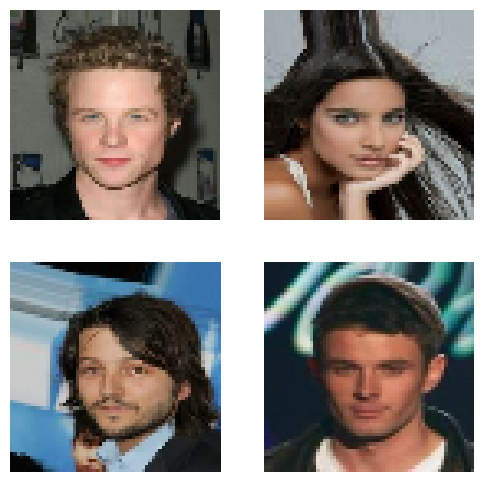

In [ ]:
# Cria uma figura com tamanho 6x6 polegadas
plt.figure(figsize=(6, 6))

k = 0         # Contador para posição dos subplots
n = 4         # Número de imagens a serem exibidas

# Loop para exibir as primeiras 'n' imagens do lote 'd'
for i in range(n):
    # Define o subplot (2 linhas x 2 colunas)
    ax = plt.subplot(2, 2, k + 1)

    # As imagens foram normalizadas para o intervalo [-1, 1]; aqui são convertidas de volta para [0, 1] para exibição
    plt.imshow((d[i] + 1) / 2)

    # Remove os eixos para visualização limpa
    plt.axis("off")

    k += 1


# Modelagem


In [ ]:
generator = tf.keras.Sequential([
    # Define a entrada do gerador: um vetor de ruído com dimensão LATENT_DIM
    Input(shape=(LATENT_DIM,)),

    # Primeira camada totalmente conectada que projeta o vetor latente para uma estrutura inicial 4x4xLATENT_DIM
    Dense(4 * 4 * LATENT_DIM),

    # Reorganiza a saída da Dense para um "mapa de características" inicial tridimensional (4x4xLATENT_DIM)
    Reshape((4, 4, LATENT_DIM)),

    # Primeira camada de deconvolução: aumenta para 8x8x512
    Conv2DTranspose(512, kernel_size=4, strides=2, padding='same'),
    BatchNormalization(),        # Normaliza os dados para ajudar na estabilidade do treinamento
    LeakyReLU(0.2),              # Ativação LeakyReLU para permitir pequenos gradientes em valores negativos

    # Segunda camada de deconvolução: aumenta para 16x16x256
    Conv2DTranspose(256, kernel_size=4, strides=2, padding='same'),
    BatchNormalization(),
    LeakyReLU(0.2),

    # Terceira camada de deconvolução: aumenta para 32x32x128
    Conv2DTranspose(128, kernel_size=4, strides=2, padding='same'),
    BatchNormalization(),
    LeakyReLU(0.2),

    # Quarta e última camada de deconvolução: aumenta para 64x64x3 (imagem RGB)
    Conv2DTranspose(3, kernel_size=4, strides=2, activation=tf.keras.activations.tanh, padding='same'),
    # Ativação Tanh para garantir que os valores estejam no intervalo [-1, 1], compatível com o pré-processamento
], name='generator')


In [ ]:
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 1600)                │         161,600 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 4, 4, 100)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 8, 8, 512)           │         819,712 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 8, 8, 512)           │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 16, 16, 256)         │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 16, 16, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 32, 32, 128)         │         524,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 32, 32, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_3 (Conv2DTranspose) │ (None, 64, 64, 3)           │           6,147 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,612,867 (13.78 MB)

 Trainable params: 3,611,075 (13.78 MB)

 Non-trainable params: 1,792 (7.00 KB)

In [ ]:
discriminator = tf.keras.Sequential([
    # Entrada do discriminador: uma imagem RGB de 64x64 pixels
    Input(shape=(IM_SHAPE[0], IM_SHAPE[1], 3)),

    # Primeira camada convolucional: reduz para 32x32x64
    Conv2D(64, kernel_size=4, strides=2, padding='same'),
    LeakyReLU(0.2),  # Ativação LeakyReLU para evitar o problema de "morte de neurônio"

    # Segunda camada convolucional: reduz para 16x16x128
    Conv2D(128, kernel_size=4, strides=2, padding='same'),
    BatchNormalization(),  # Ajuda a estabilizar o treinamento
    LeakyReLU(0.2),

    # Terceira camada convolucional: reduz para 8x8x256
    Conv2D(256, kernel_size=4, strides=2, padding='same'),
    BatchNormalization(),
    LeakyReLU(0.2),

    # Camada convolucional final: reduz para 4x4x1
    Conv2D(1, kernel_size=4, strides=2, padding='same'),

    # Achata os mapas de características para um vetor
    Flatten(),

    # Camada densa final com ativação sigmoid: retorna probabilidade de a imagem ser real (1) ou falsa (0)
    Dense(1, activation='sigmoid')
], name='discriminator')


In [ ]:
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 32, 32, 64)          │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_3 (LeakyReLU)            │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 16, 16, 128)         │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_4 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 8, 8, 256)           │         524,544 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 8, 8, 256)           │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_5 (LeakyReLU)            │ (None, 8, 8, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 4, 4, 1)             │           4,097 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 16)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 664,530 (2.53 MB)

 Trainable params: 663,762 (2.53 MB)

 Non-trainable params: 768 (3.00 KB)

In [ ]:
# Callback personalizado do Keras para gerar e salvar imagens ao final de cada época
class ShowImage(tf.keras.callbacks.Callback):
    def __init__(self, latent_dim=100):
        # Define a dimensão do vetor de entrada do gerador (espaço latente)
        self.latent_dim = latent_dim

    # Este método é chamado automaticamente ao final de cada época durante o treinamento
    def on_epoch_end(self, epoch, logs=None):
        n = 6      # Define uma grade n x n de imagens
        k = 0      # Contador de imagens

        # Gera 36 imagens falsas (6x6) a partir de vetores de ruído amostrados da distribuição normal padrão
        out = self.model.generator(tf.random.normal(shape=(36, self.latent_dim)))

        # Cria uma figura grande para visualização
        plt.figure(figsize=(16, 16))

        # Plota cada imagem gerada na grade
        for i in range(n):
            for j in range(n):
                ax = plt.subplot(n, n, k + 1)
                plt.imshow((out[k] + 1) / 2)  # Desfaz a normalização (-1 a 1) para o intervalo [0, 1]
                plt.axis('off')  # Remove os eixos para visualização mais limpa
                k += 1

        # Salva a imagem gerada da época atual no diretório "generated"
        plt.savefig("generated/gen_images_epoch_{}.png".format(epoch + 1))


In [ ]:
# Define a classe customizada GAN herdando de tf.keras.Model
class GAN(tf.keras.Model):
    def __init__(self, discriminator, generator):
        super(GAN, self).__init__()
        self.discriminator = discriminator  # Modelo que julga se a imagem é real ou falsa
        self.generator = generator          # Modelo que gera imagens falsas a partir de ruído

    # Método que define os otimizadores e função de perda
    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(GAN, self).compile()
        self.d_optimizer = d_optimizer        # Otimizador do discriminador
        self.g_optimizer = g_optimizer        # Otimizador do gerador
        self.loss_fn = loss_fn                # Função de perda (ex: binary crossentropy)

        # Métricas para monitorar a perda de cada rede
        self.d_loss_metric = tf.keras.metrics.Mean(name='d_loss')
        self.g_loss_metric = tf.keras.metrics.Mean(name='g_loss')

    # Retorna as métricas que serão monitoradas durante o treinamento
    @property
    def metrics(self):
        return [self.d_loss_metric, self.g_loss_metric]

    # Define o passo de treinamento personalizado da GAN
    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]

        ########## Treinamento do Discriminador ##########

        # Gera imagens falsas a partir de ruído aleatório
        random_noise = tf.random.normal(shape=(batch_size, LATENT_DIM))
        fake_images = self.generator(random_noise)

        # Rótulos reais (com ruído para suavizar o treinamento - label smoothing)
        real_labels = tf.ones((batch_size, 1)) + 0.25 * tf.random.uniform((batch_size, 1), minval=-1, maxval=1)
        # Rótulos falsos com ruído também
        fake_labels = tf.zeros((batch_size, 1)) + 0.25 * tf.random.uniform((batch_size, 1))

        # Calcula as perdas do discriminador
        with tf.GradientTape() as recorder:
            real_predictions = self.discriminator(real_images)
            d_loss_real = self.loss_fn(real_labels, real_predictions)

            fake_predictions = self.discriminator(fake_images)
            d_loss_fake = self.loss_fn(fake_labels, fake_predictions)

            # Perda total do discriminador
            d_loss = d_loss_real + d_loss_fake

        # Atualiza os pesos do discriminador
        partial_derivatives = recorder.gradient(d_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(zip(partial_derivatives, self.discriminator.trainable_weights))

        ########## Treinamento do Gerador ##########

        # Gera novo ruído
        random_noise = tf.random.normal(shape=(batch_size, LATENT_DIM))
        # O objetivo do gerador é "enganar" o discriminador, então os rótulos são todos 1
        flipped_fake_labels = tf.ones((batch_size, 1))

        with tf.GradientTape() as recorder:
            fake_predictions = self.discriminator(self.generator(random_noise))
            # O gerador tenta fazer o discriminador acreditar que as imagens falsas são reais
            g_loss = self.loss_fn(flipped_fake_labels, fake_predictions)

        # Atualiza os pesos do gerador
        partial_derivatives = recorder.gradient(g_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(zip(partial_derivatives, self.generator.trainable_weights))

        # Atualiza as métricas
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        # Retorna um dicionário com as métricas da época atual
        return {
            'd_loss': self.d_loss_metric.result(),
            'g_loss': self.g_loss_metric.result()
        }


In [ ]:
# Cria uma instância da classe GAN, passando o gerador e o discriminador definidos anteriormente
gan = GAN(discriminator, generator)

# Compila a GAN, definindo otimizadores e função de perda
gan.compile(
    # Otimizador do discriminador: Adam com taxa de aprendizado definida e beta_1=0.5 (recomendado para GANs)
    d_optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE, beta_1=0.5),

    # Otimizador do gerador: mesma configuração do discriminador
    g_optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE, beta_1=0.5),

    # Função de perda binária cruzada: mede o quão bem o discriminador distingue real de falso
    loss_fn=tf.keras.losses.BinaryCrossentropy(),
)


In [ ]:
!mkdir generated

Epoch 1/10
   1581/Unknown 82s 42ms/step - d_loss: 1.0905 - g_loss: 1.0690

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/epoch_iterator.py:151: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()



1582/1582 ━━━━━━━━━━━━━━━━━━━━ 84s 43ms/step - d_loss: 1.0906 - g_loss: 1.0688
Epoch 2/10
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 67s 42ms/step - d_loss: 1.1552 - g_loss: 0.9800
Epoch 3/10
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 67s 42ms/step - d_loss: 1.1987 - g_loss: 0.8978
Epoch 4/10
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 67s 42ms/step - d_loss: 1.2203 - g_loss: 0.8555
Epoch 5/10
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 67s 42ms/step - d_loss: 1.2237 - g_loss: 0.8442
Epoch 6/10
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 67s 43ms/step - d_loss: 1.2306 - g_loss: 0.8321
Epoch 7/10
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 67s 42ms/step - d_loss: 1.2328 - g_loss: 0.8344
Epoch 8/10
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 67s 42ms/step - d_loss: 1.2266 - g_loss: 0.8355
Epoch 9/10
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 67s 42ms/step - d_loss: 1.2134 - g_loss: 0.8453
Epoch 10/10
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 67s 42ms/step - d_loss: 1.1959 - g_loss: 0.8544


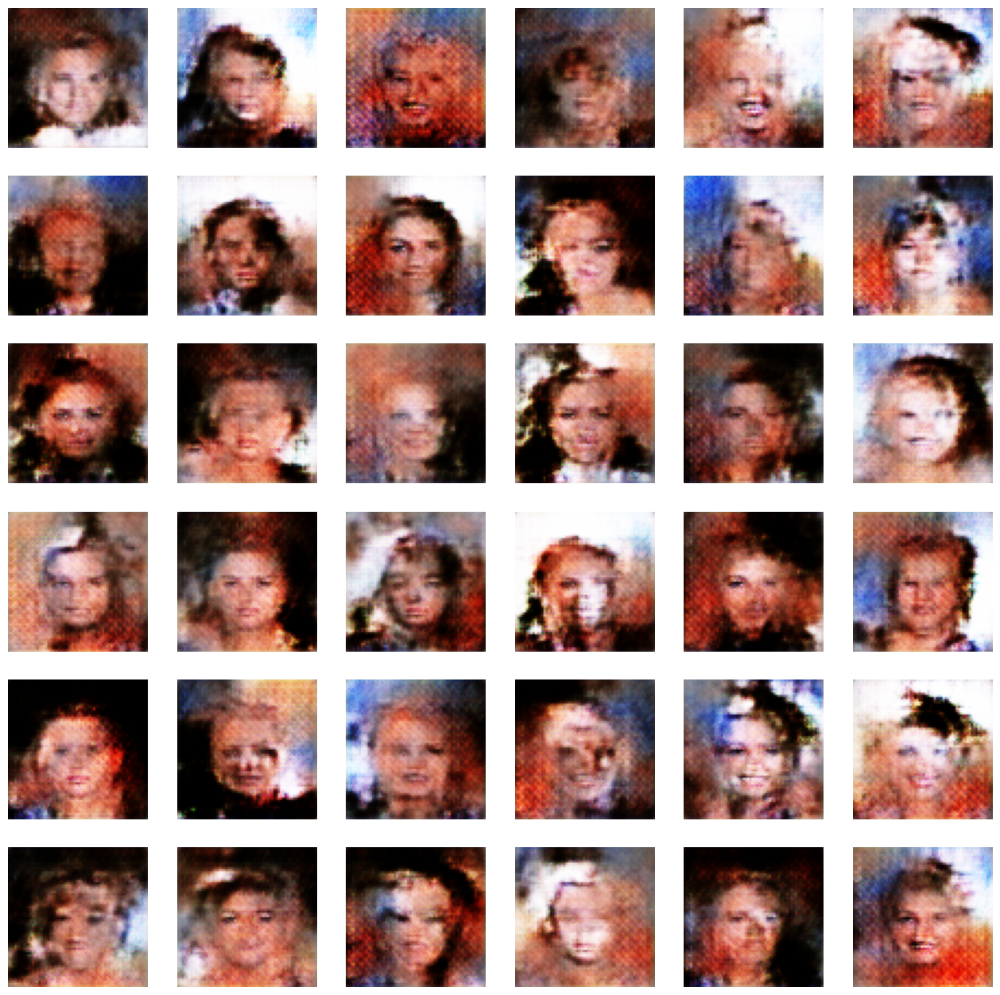

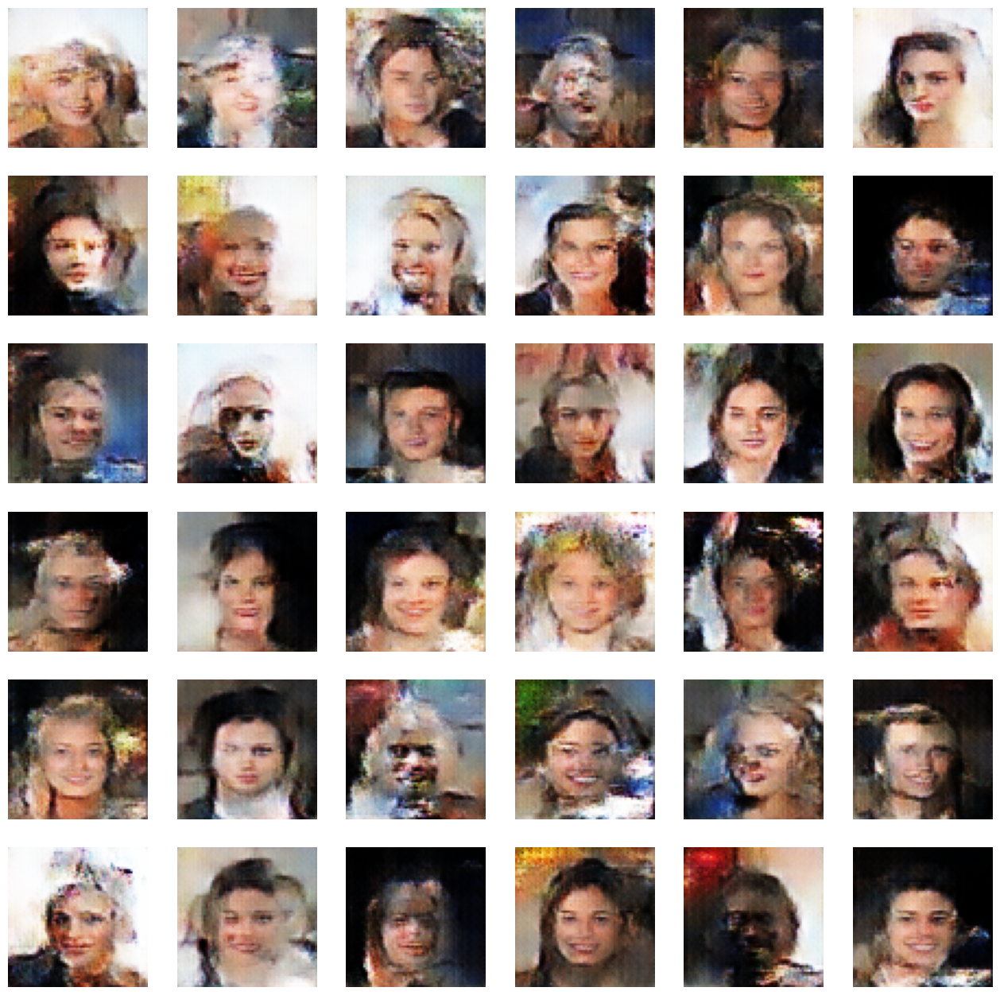

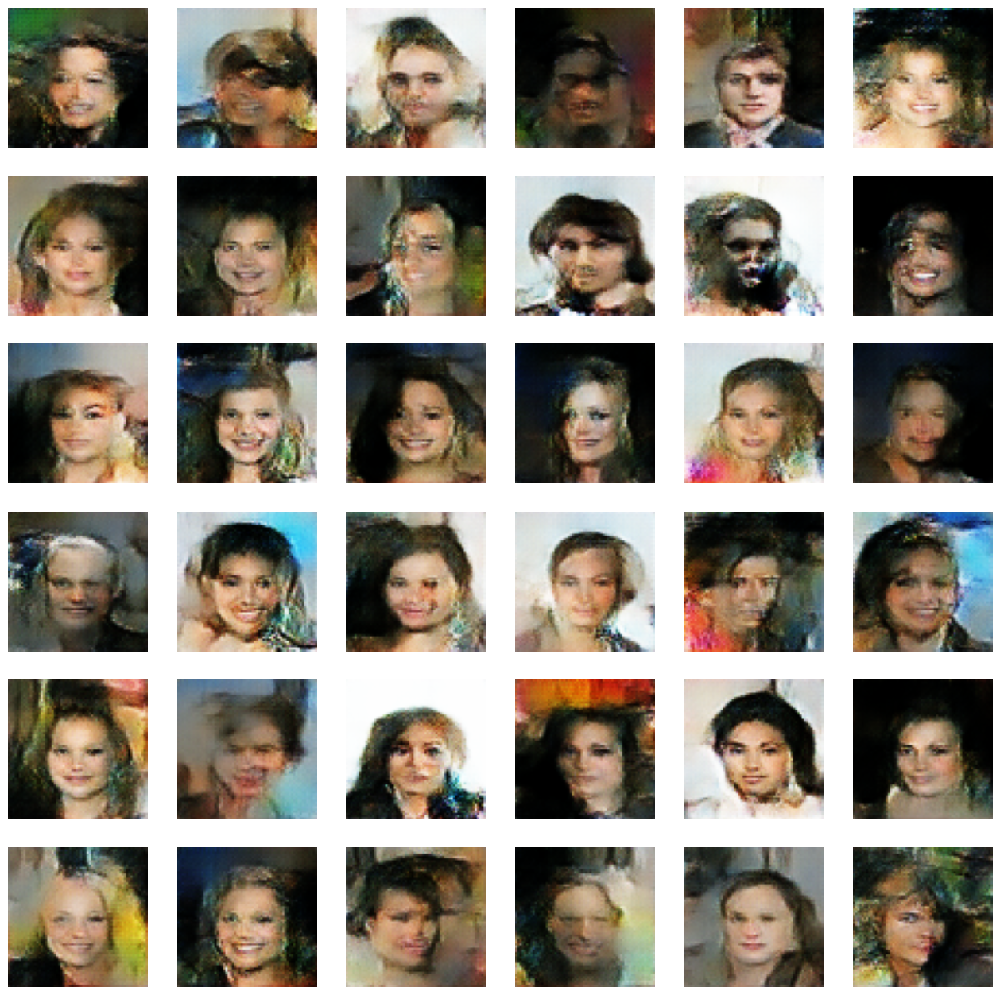

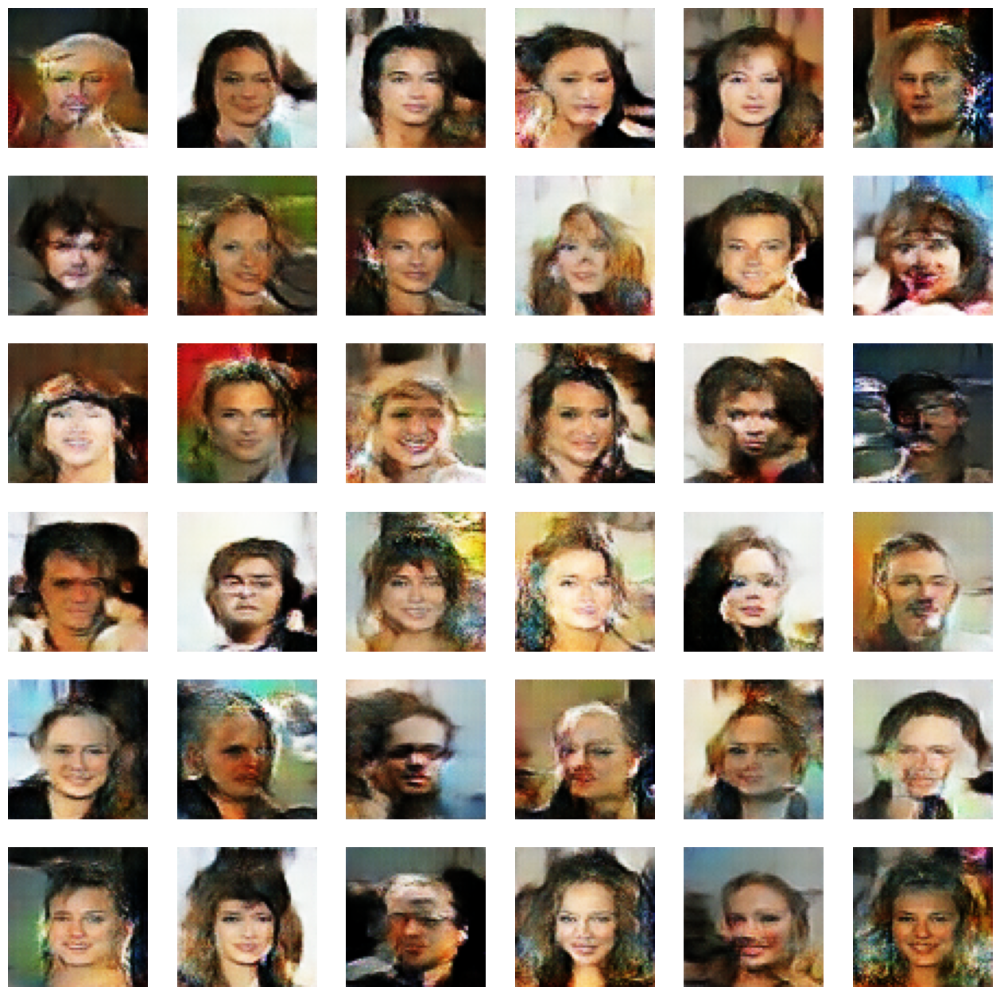

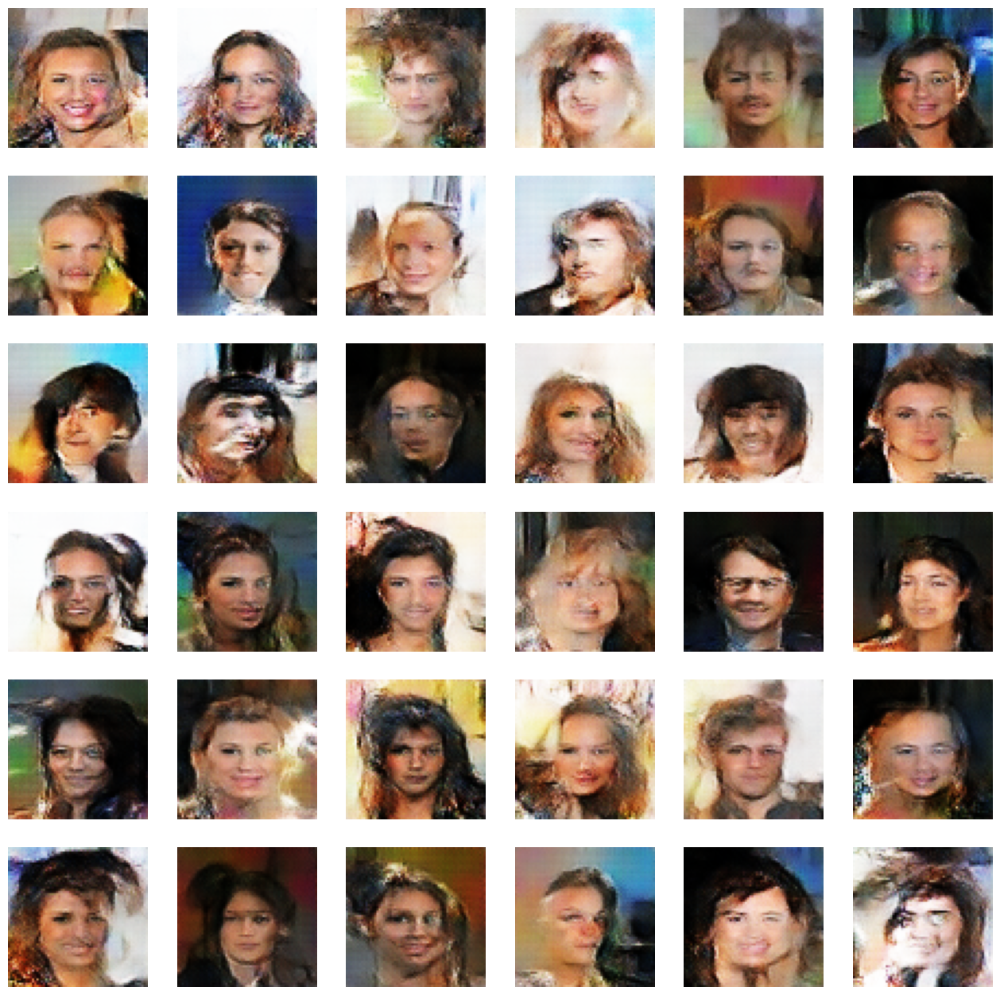

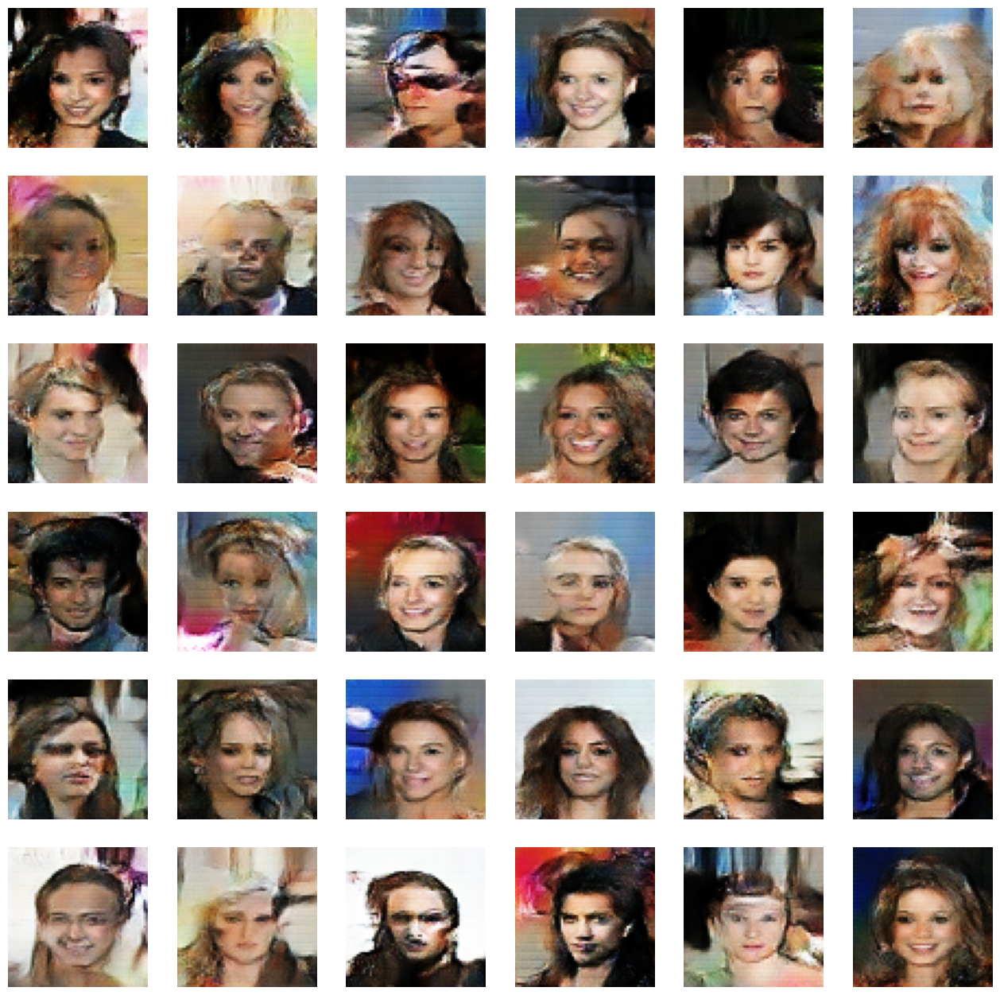

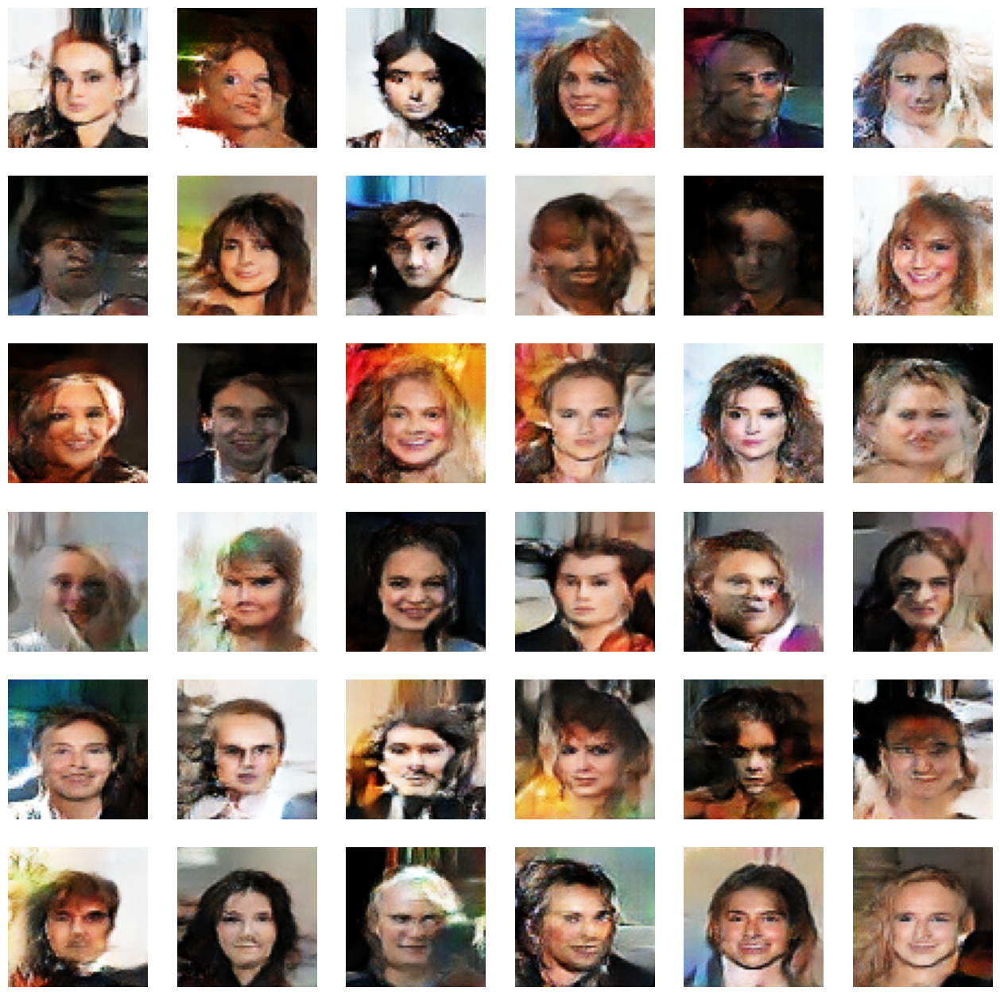

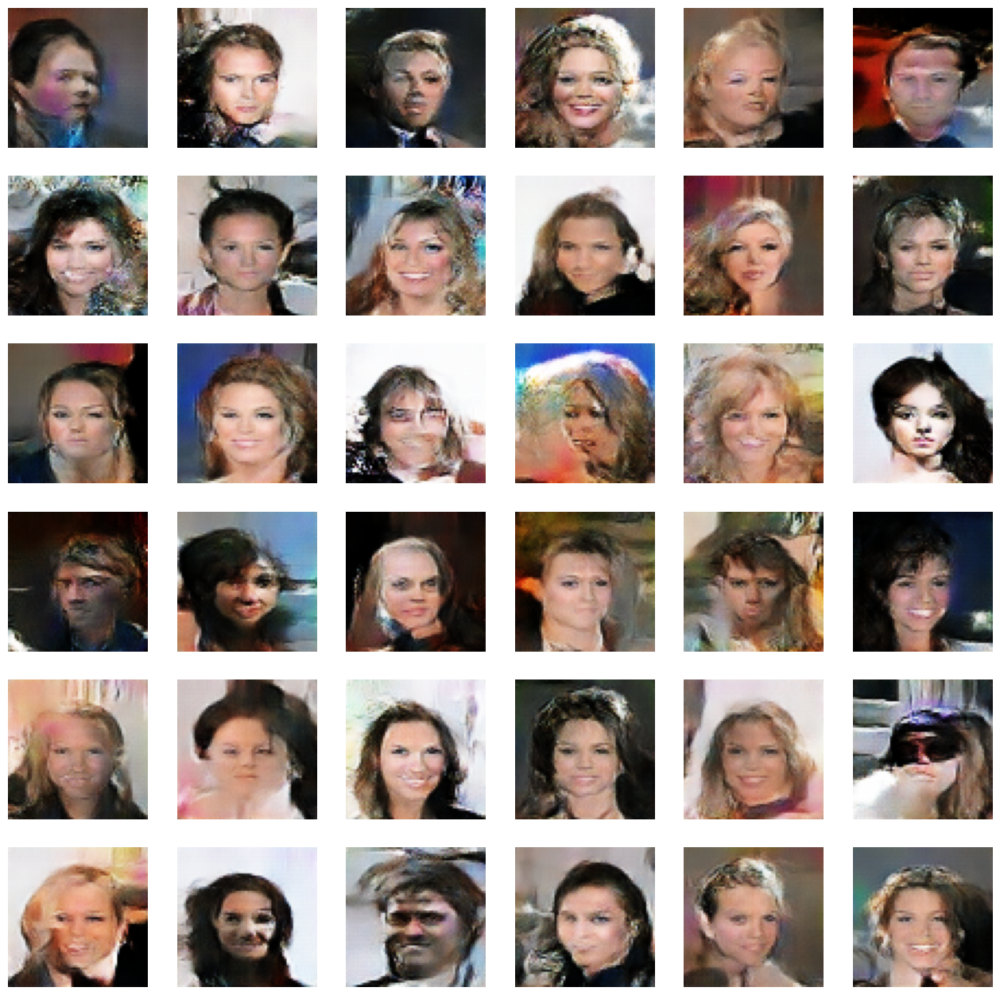

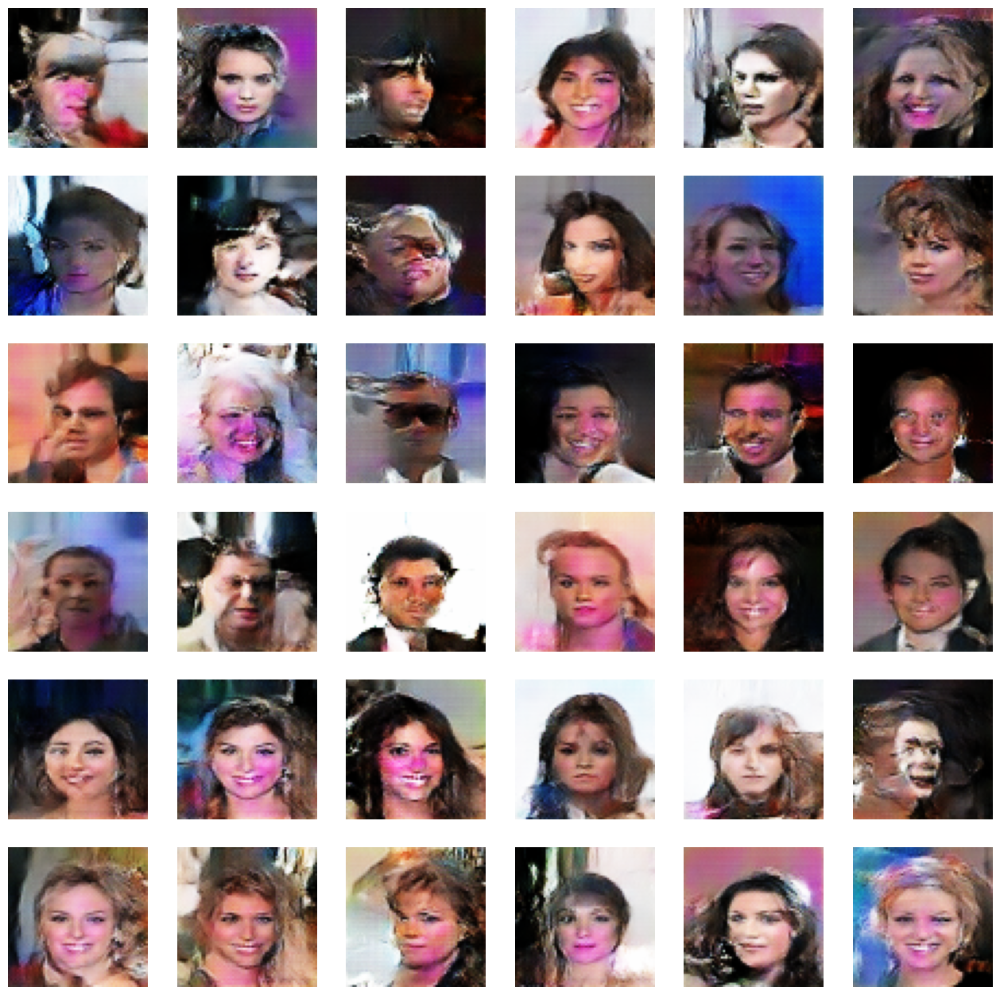

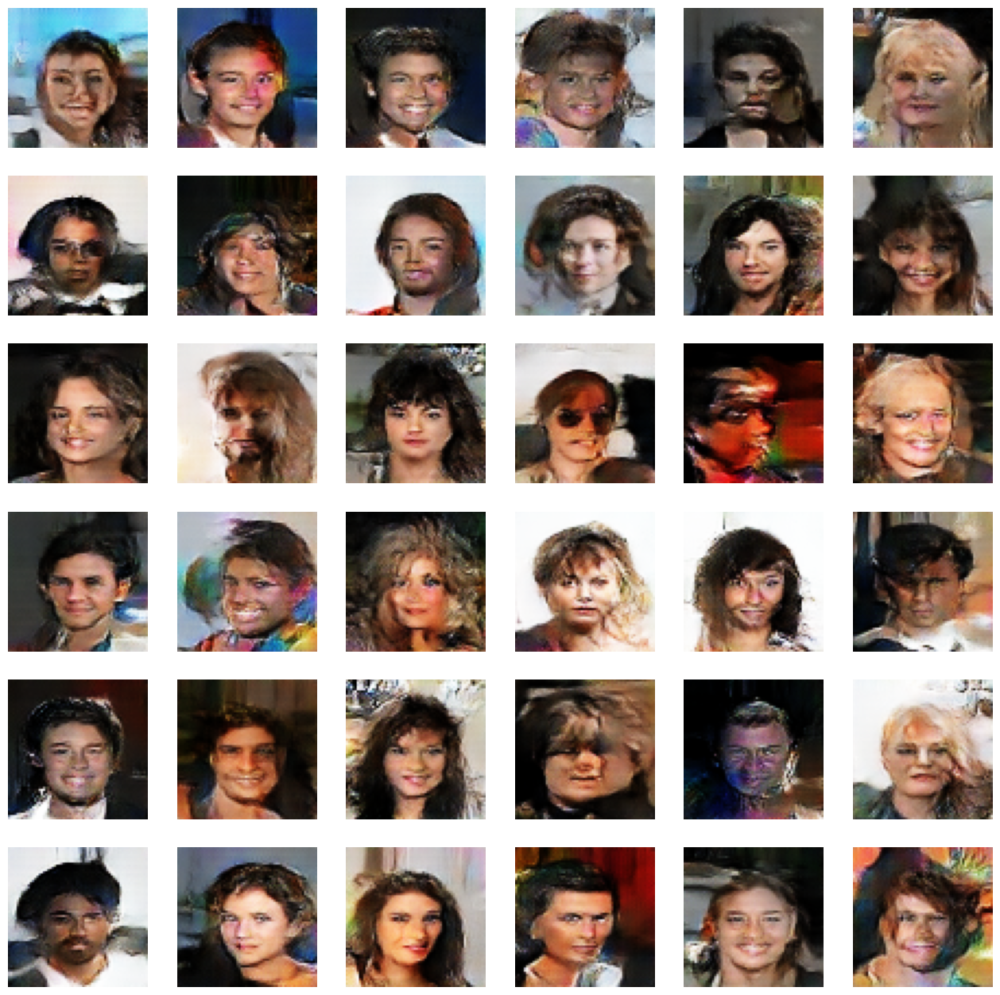

In [ ]:
EPOCHS=10
history=gan.fit(train_dataset,epochs=EPOCHS,callbacks=[ShowImage(LATENT_DIM)])

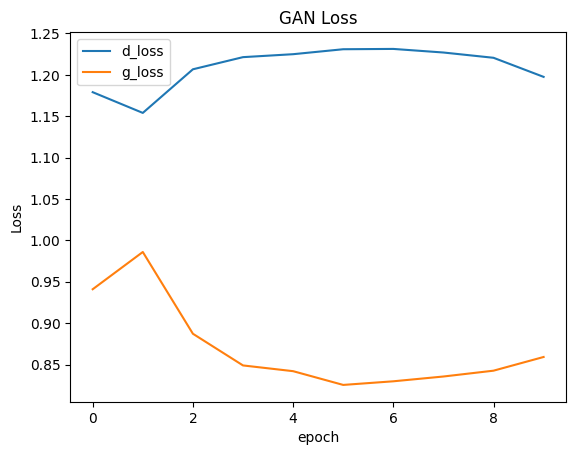

In [ ]:
plt.plot(history.history['d_loss'])
plt.plot(history.history['g_loss'])
plt.title('GAN Loss')
plt.ylabel('Loss')
plt.xlabel('epoch')
plt.legend(['d_loss', 'g_loss'], loc='upper left')
plt.show()

## Discriminador (d_loss):

- Começa em torno de 1.18, tem uma queda na época 1, depois sobe e se mantém acima de 1.20 até cair levemente no final. Isso indica que o discriminador está tendo alguma dificuldade para distinguir as imagens falsas das reais com o tempo — sinal de que o gerador pode estar melhorando.

## Gerador (g_loss):

- Começa alto (cerca de 0.94), cai até um mínimo (cerca de 0.82) na época 5, depois sobe levemente. A queda indica que o gerador está melhorando - produzindo imagens mais convincentes. A leve subida depois pode indicar que o discriminador está se adaptando, dificultando um pouco mais para o gerador.